# Exploring Metrics for Business Popularity

In [1]:
import json
import pandas as pd
import numpy as np
import math
import datetime

import matplotlib.pyplot as plt

import collections

from sklearn.preprocessing import MinMaxScaler

In [2]:
business_df = pd.read_json('./yelp/yelp_academic_dataset_business.json', lines=True)
business_df.drop(columns=['address', 'postal_code', 'name'], inplace=True)
# business_df.dropna(inplace=True)  # the nans are for attributes and opening hours: may not be integral part
business_df.set_index("business_id", inplace=True)
print(len(business_df))

checkins_df = pd.read_json('./yelp/yelp_academic_dataset_checkin.json', lines=True)
print(len(checkins_df))

160585
138876


In [3]:
def plot_loglog(series, return_vals=False, do_plot=True):
    count_sequence = sorted(series, reverse=True)  # degree sequence
    binCount = collections.Counter(count_sequence)
    val, cnt = zip(*binCount.items())
    if do_plot:
        plt.loglog(val, cnt)
    if return_vals:
        return val, cnt

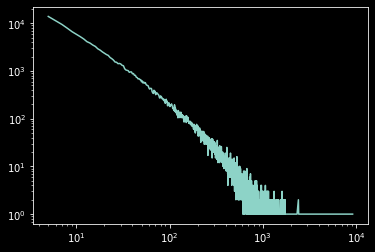

In [4]:
plot_loglog(business_df["review_count"])

In [5]:
def calculate_frequency(row):
    dates = row.split(",")
    count = len(dates)
    if count == 0 or count == 1:
        return 0
    
    first_date = datetime.datetime.strptime(dates[0].strip(), "%Y-%m-%d %H:%M:%S")
    last_date = datetime.datetime.strptime(dates[len(dates)-1].strip(), "%Y-%m-%d %H:%M:%S")
    # last_date = datetime.datetime.strptime("2021-04-01", "%Y-%m-%d")
    time_period = last_date - first_date

    if time_period.days <= 5:
        return 0
    
    return round(count/time_period.days, 5)

def calculate_checkin_count(row):
    dates = row.split(",")
    return len(dates)

def start_date(row):
    dates = row.split(",")
    return dates[0]

def last_date(row):
    dates = row.split(",")
    return dates[-1]

checkins_df['frequency'] = checkins_df["date"].apply(calculate_frequency)
checkins_df['checkin_count'] = checkins_df["date"].apply(calculate_checkin_count)
checkins_df['first_checkin'] = checkins_df["date"].apply(start_date)
checkins_df['last_checkin'] = checkins_df["date"].apply(last_date)
checkins_df.head()

,business_id,date,frequency,checkin_count,first_checkin,last_checkin
0,--0r8K_AQ4FZfLsX3ZYRDA,2017-09-03 17:13:59,0.00000,1,2017-09-03 17:13:59,2017-09-03 17:13:59
1,--0zrn43LEaB4jUWTQH_Bg,"2010-10-08 22:21:20, 2010-11-01 21:29:14, 2010...",0.02778,9,2010-10-08 22:21:20,2011-08-29 19:01:31
2,--164t1nclzzmca7eDiJMw,"2010-02-26 02:06:53, 2010-02-27 08:00:09, 2010...",0.22734,311,2010-02-26 02:06:53,2013-11-25 02:51:33
3,--2aF9NhXnNVpDV0KS3xBQ,"2014-11-03 16:35:35, 2015-01-30 18:16:03, 2015...",0.00356,8,2014-11-03 16:35:35,2020-12-29 16:22:00
4,--2mEJ63SC_8_08_jGgVIg,"2010-12-15 17:10:46, 2013-12-28 00:27:54, 2015...",0.00200,4,2010-12-15 17:10:46,2016-06-11 19:56:11


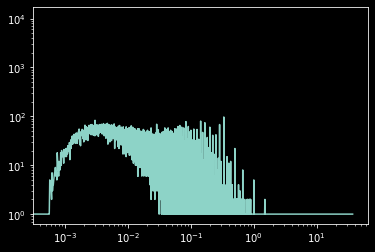

In [6]:
plot_loglog(checkins_df['frequency'])

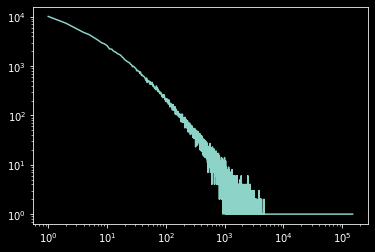

In [7]:
plot_loglog(checkins_df['checkin_count'])

## Complementary data from reviews

In [8]:
reviews_df = pd.read_json('yelp/yelp_academic_dataset_review.json', lines=True)

reviews_df.drop(columns=["text", "user_id", "review_id"])

,business_id,stars,useful,funny,cool,date
0,buF9druCkbuXLX526sGELQ,4,3,1,1,2014-10-11 03:34:02
1,RA4V8pr014UyUbDvI-LW2A,4,1,0,0,2015-07-03 20:38:25
2,_sS2LBIGNT5NQb6PD1Vtjw,5,0,0,0,2013-05-28 20:38:06
3,0AzLzHfOJgL7ROwhdww2ew,2,1,1,1,2010-01-08 02:29:15
4,8zehGz9jnxPqXtOc7KaJxA,4,0,0,0,2011-07-28 18:05:01
...,...,...,...,...,...,...
8635398,yyTtwwQ4JnQMJ2rn3W0S0g,1,0,0,0,2021-01-26 04:07:14
8635399,RDgwjgbu5xziFIAaNn3WCQ,1,13,1,0,2019-05-01 21:21:43
8635400,rbuj2X4SXIc3MDul4dcxIA,5,39,13,34,2020-06-13 02:39:26
8635401,IRzjEZ2pX4iOpnBG7oZJ7g,2,2,0,0,2020-06-22 21:54:10


In [9]:
def round_star(raw_star):

    i = raw_star // 1
    f = raw_star % 1
    if f >= 0.75:
        ans = i + 1
    elif f >=0.25:
        ans = i + 0.5
    else:
        ans = i

    return ans

business_df["raw_stars"] = reviews_df.groupby("business_id").mean()["stars"]
business_df["rounded_stars"] = business_df["raw_stars"].apply(round_star)

business_df[["stars", "rounded_stars", "raw_stars"]]

,stars,rounded_stars,raw_stars
business_id,,,
6iYb2HFDywm3zjuRg0shjw,4.0,4.0,4.000000
tCbdrRPZA0oiIYSmHG3J0w,4.0,4.0,4.193798
bvN78flM8NLprQ1a1y5dRg,4.5,4.5,4.615385
oaepsyvc0J17qwi8cfrOWg,3.0,2.5,2.666667
PE9uqAjdw0E4-8mjGl3wVA,4.0,4.0,4.214286
...,...,...,...
D2mHoIDXx9N8mS1pGoKV9Q,4.0,4.0,4.000000
bQX-kwVTyZgcdZGEPzce6Q,4.5,4.5,4.368421
wvFZ06nmPmQ2-IVoPqVYLA,5.0,5.0,4.875000


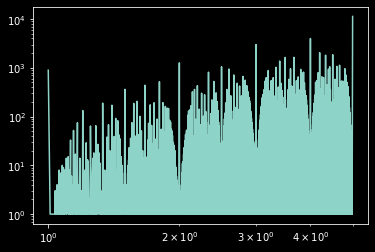

In [10]:
plot_loglog(business_df["raw_stars"])

In [11]:
reviews_df.groupby("stars").mean()

,useful,funny,cool
stars,,,
1,2.021785,0.554113,0.200847
2,1.518487,0.555006,0.320194
3,1.182473,0.501506,0.516838
4,1.192566,0.475959,0.726385
5,0.988147,0.301180,0.519650


In [50]:
weights = reviews_df.groupby("stars").mean()["useful"].values

weights[:1] = -weights[:1]

reviews_df["weighted_stars"] = reviews_df["stars"].apply(lambda x: x * weights[x - 1])
# reviews_df["weighted_stars"] = (reviews_df["stars"] - 3) * reviews_df["useful"]

business_df["weighted_stars"] = reviews_df.groupby("business_id").mean()["weighted_stars"]
business_df[["stars", "raw_stars", "rounded_stars", "weighted_stars"]]

,stars,raw_stars,rounded_stars,weighted_stars
business_id,,,,
6iYb2HFDywm3zjuRg0shjw,4.0,4.000000,4.0,3.865064
tCbdrRPZA0oiIYSmHG3J0w,4.0,4.193798,4.0,4.370360
bvN78flM8NLprQ1a1y5dRg,4.5,4.615385,4.5,4.875167
oaepsyvc0J17qwi8cfrOWg,3.0,2.666667,2.5,1.517714
PE9uqAjdw0E4-8mjGl3wVA,4.0,4.214286,4.0,4.108383
...,...,...,...,...
D2mHoIDXx9N8mS1pGoKV9Q,4.0,4.000000,4.0,3.200104
bQX-kwVTyZgcdZGEPzce6Q,4.5,4.368421,4.5,4.116560
wvFZ06nmPmQ2-IVoPqVYLA,5.0,4.875000,5.0,4.919424


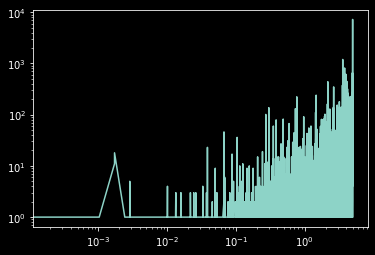

In [51]:
plot_loglog(business_df["weighted_stars"])


In [52]:
reviews_df["date"] = pd.to_datetime(reviews_df["date"])

def get_freq(x):
    last_date = datetime.datetime.strptime("2021-04-01", "%Y-%m-%d")
    period = (x.max() - x.min()).days
    if period <= 5:
        return 0
    return x.count() / period

def get_start_date(x):
    return x.min()

business_df["review_freq"] = reviews_df.groupby(by='business_id').agg(review_freq=("date", get_freq))
business_df["first_review"] = reviews_df.groupby(by='business_id').agg(first_review=("date", get_start_date))
business_df["last_review"] = reviews_df.groupby(by='business_id').agg(first_review=("date", lambda x: x.max()))
business_df[["review_freq", "review_count"]].corr()

,review_freq,review_count
review_freq,1.00000,0.58495
review_count,0.58495,1.00000


In [53]:
business_df["rev_count_raw"] = reviews_df.groupby("business_id").count()["stars"]

business_df[["review_count", "rev_count_raw", "review_freq"]]

,review_count,rev_count_raw,review_freq
business_id,,,
6iYb2HFDywm3zjuRg0shjw,86,86,0.070033
tCbdrRPZA0oiIYSmHG3J0w,126,129,0.033930
bvN78flM8NLprQ1a1y5dRg,13,13,0.005963
oaepsyvc0J17qwi8cfrOWg,8,9,0.003303
PE9uqAjdw0E4-8mjGl3wVA,14,14,0.007726
...,...,...,...
D2mHoIDXx9N8mS1pGoKV9Q,8,8,0.005191
bQX-kwVTyZgcdZGEPzce6Q,18,19,0.005108
wvFZ06nmPmQ2-IVoPqVYLA,8,8,0.010596


## Restaurants

In [54]:
restaurants_df = business_df.loc[business_df["categories"].str.contains("Restaurants") | business_df["categories"].str.contains("Food")]
print(f"There are {len(restaurants_df)} restaurants in the dataset")

restaurants_df = pd.merge(restaurants_df, checkins_df, on='business_id')
restaurants_df.head(3)

There are 63898 restaurants in the dataset


,business_id,city,state,latitude,longitude,stars,review_count,is_open,attributes,categories,...,weighted_stars,review_freq,first_review,last_review,rev_count_raw,date,frequency,checkin_count,first_checkin,last_checkin
0,6iYb2HFDywm3zjuRg0shjw,Boulder,CO,40.017544,-105.283348,4.0,86,1,"{'RestaurantsTableService': 'True', 'WiFi': 'u...","Gastropubs, Food, Beer Gardens, Restaurants, B...",...,3.865064,0.070033,2017-09-12 03:32:30,2021-01-22 05:20:38,86,"2017-09-10 04:48:12, 2017-09-10 04:49:28, 2017...",0.15082,184,2017-09-10 04:48:12,2021-01-13 00:27:11
1,tCbdrRPZA0oiIYSmHG3J0w,Portland,OR,45.588906,-122.593331,4.0,126,1,"{'RestaurantsTakeOut': 'True', 'RestaurantsAtt...","Salad, Soup, Sandwiches, Delis, Restaurants, C...",...,4.370360,0.033930,2010-03-09 16:02:04,2020-08-06 09:00:59,129,"2010-04-22 05:31:33, 2010-05-09 18:24:50, 2010...",0.30048,1180,2010-04-22 05:31:33,2021-01-21 17:55:35
2,D4JtQNTI4X3KcbzacDJsMw,Vancouver,BC,49.251342,-123.101333,3.5,169,1,"{'GoodForKids': 'True', 'Alcohol': 'u'none'', ...","Restaurants, Thai",...,3.986256,0.046766,2010-09-26 04:03:35,2020-12-24 21:24:42,175,"2010-11-06 02:53:03, 2010-11-29 02:16:55, 2010...",0.07721,288,2010-11-06 02:53:03,2021-01-23 01:43:50


In [55]:
def get_log_metric(series):
    metric = np.log(series)
    metric[metric == -np.inf] = 0
    return metric

def classify_popular(top, median, bottom):
    # if score >= mean + std:
    #     return 3
    # if score >= mean:
    #     return 2
    # if score >= mean - std:
    #     return 1
    def _classify_popular(score):
        if score >= top:
            return 3
        if score >= median:
            return 2
        if score >= bottom:
            return 1
        return 0
    return _classify_popular



In [56]:
restaurants_df["scaled_weighted_stars"] = MinMaxScaler((1,5)).fit_transform(restaurants_df["weighted_stars"].values.reshape(-1 ,1)).squeeze()

restaurants_df["total_visit_count"] = restaurants_df["checkin_count"] + restaurants_df["rev_count_raw"]

restaurants_df["weighted_review_freq"] = restaurants_df["review_freq"] * restaurants_df["weighted_stars"]

restaurants_df["total_weighted"] = MinMaxScaler((0, 1)).fit_transform(restaurants_df["total_visit_count"].values.reshape(-1, 1)).squeeze() * MinMaxScaler((1, 5)).fit_transform(restaurants_df["weighted_stars"].values.reshape(-1, 1)).squeeze()

In [57]:
restaurants_df["first_checkin"] = pd.to_datetime(restaurants_df["first_checkin"])
restaurants_df["first_review"] = pd.to_datetime(restaurants_df["first_review"])

restaurants_df["last_checkin"] = pd.to_datetime(restaurants_df["last_checkin"])
restaurants_df["last_review"] = pd.to_datetime(restaurants_df["last_review"])

restaurants_df["first_date"] = restaurants_df[["first_checkin", "first_review"]].min(axis=1)
restaurants_df["last_date"] = restaurants_df[["last_checkin", "last_review"]].max(axis=1)

restaurants_df["total_duration"] = (restaurants_df["last_date"] - restaurants_df["first_date"]).dt.days

restaurants_df["total_freq"] = restaurants_df["total_visit_count"] / restaurants_df["total_duration"]

In [58]:
restaurants_df["weighted_stars_sum"] = restaurants_df["weighted_stars"] * restaurants_df["rev_count_raw"] + restaurants_df["checkin_count"]
restaurants_df["total_weighted_freq"] = restaurants_df["weighted_stars_sum"] / restaurants_df["total_duration"]

restaurants_df["total_duration_times_visit"] = MinMaxScaler((0, 1)).fit_transform(restaurants_df["total_visit_count"].values.reshape(-1, 1)).squeeze() + MinMaxScaler((0, 1)).fit_transform(restaurants_df["total_freq"].values.reshape(-1,1)).squeeze()

In [59]:
restaurants_df.head()

,business_id,city,state,latitude,longitude,stars,review_count,is_open,attributes,categories,...,total_visit_count,weighted_review_freq,total_weighted,first_date,last_date,total_duration,total_freq,weighted_stars_sum,total_weighted_freq,total_duration_times_visit
0,6iYb2HFDywm3zjuRg0shjw,Boulder,CO,40.017544,-105.283348,4.0,86,1,"{'RestaurantsTableService': 'True', 'WiFi': 'u...","Gastropubs, Food, Beer Gardens, Restaurants, B...",...,270,0.270680,0.039109,2017-09-10 04:48:12,2021-01-22 05:20:38,1230,0.219512,516.395481,0.419834,0.040082
1,tCbdrRPZA0oiIYSmHG3J0w,Portland,OR,45.588906,-122.593331,4.0,126,1,"{'RestaurantsTakeOut': 'True', 'RestaurantsAtt...","Salad, Soup, Sandwiches, Delis, Restaurants, C...",...,1309,0.148284,0.205816,2010-03-09 16:02:04,2021-01-21 17:55:35,3971,0.329640,1743.776400,0.439128,0.090943
2,D4JtQNTI4X3KcbzacDJsMw,Vancouver,BC,49.251342,-123.101333,3.5,169,1,"{'GoodForKids': 'True', 'Alcohol': 'u'none'', ...","Restaurants, Thai",...,463,0.186423,0.068776,2010-09-26 04:03:35,2021-01-23 01:43:50,3771,0.122779,985.594885,0.261362,0.032785
3,jFYIsSb7r1QeESVUnXPHBw,Columbus,OH,39.947007,-82.997471,4.5,11,1,None,"Breakfast & Brunch, Restaurants",...,18,0.628384,0.001995,2020-08-29 16:18:20,2020-11-22 14:24:43,84,0.214286,59.784281,0.711718,0.030816
4,rYs_1pNB_RMtn5WQh55QDA,Boulder,CO,39.998449,-105.281006,3.5,5,1,"{'BikeParking': 'True', 'RestaurantsTakeOut': ...","Food, Shopping, Convenience Stores, Souvenir S...",...,14,0.007284,0.001087,2014-08-23 18:24:18,2020-09-21 21:25:10,2221,0.006303,25.177364,0.011336,0.000963


In [60]:
def get_closed_ratio(df):
    if len(df) == 0:
        return
    closed = df[df["is_open"] == 0]
    print(f"{round(len(closed) / len(df)*100, 2)}%")
    
    random_df = restaurants_df.sample(n=len(df))
    random_closed = random_df[random_df["is_open"] == 0]
    print(f"random: {round(len(random_closed) / len(random_df)*100, 2)}%")

def get_ratio_for_metric(metric):
    if metric[:3] == "log":
        restaurants_df[metric] = get_log_metric(restaurants_df[metric[4:]])
    bottom = restaurants_df[metric].describe()["25%"]
    median = restaurants_df[metric].describe()["50%"]
    top = restaurants_df[metric].describe()["75%"]

    restaurants_df["popularity"] = restaurants_df[metric].apply(classify_popular(top, median, bottom))

    for i in range(4):
        print(i, end=" ")
        get_closed_ratio(restaurants_df[restaurants_df["popularity"] == i])


In [61]:
for metric in ["frequency", "checkin_count", "rev_count_raw", "review_freq", "weighted_review_freq", "total_duration", "total_visit_count","total_freq", "weighted_stars_sum", "total_weighted_freq", "weighted_stars", "total_duration_times_visit"]:
    print(metric)
    get_ratio_for_metric(metric)
    print()

frequency
0 26.68%
random: 33.34%
1 35.69%
random: 33.55%
2 38.18%
random: 33.68%
3 34.42%
random: 33.04%

checkin_count
0 41.04%
random: 33.94%
1 38.37%
random: 34.04%
2 33.75%
random: 34.24%
3 21.92%
random: 34.09%

rev_count_raw
0 42.58%
random: 34.04%
1 36.9%
random: 33.85%
2 33.19%
random: 33.37%
3 22.73%
random: 33.7%

review_freq
0 27.73%
random: 33.91%
1 36.33%
random: 33.7%
2 38.49%
random: 34.65%
3 32.41%
random: 33.7%

weighted_review_freq
0 25.0%
random: 33.13%
1 38.44%
random: 33.6%
2 39.89%
random: 33.59%
3 31.64%
random: 33.7%

total_duration
0 50.83%
random: 33.67%
1 43.62%
random: 33.23%
2 28.49%
random: 33.53%
3 12.05%
random: 33.88%

total_visit_count
0 42.31%
random: 33.83%
1 37.87%
random: 33.66%
2 33.1%
random: 33.86%
3 21.78%
random: 33.22%

total_freq
0 30.44%
random: 33.35%
1 36.87%
random: 33.95%
2 36.66%
random: 34.07%
3 31.0%
random: 33.81%

weighted_stars_sum
0 40.26%
random: 33.67%
1 39.22%
random: 33.47%
2 33.48%
random: 34.04%
3 22.01%
random: 33.64%

to

In [62]:
restaurants_df[["frequency", "checkin_count", "rev_count_raw", "review_freq", "weighted_review_freq", "total_duration", "total_visit_count", "total_duration_times_visit","total_freq", "total_weighted", "total_weighted_freq", "weighted_stars", "is_open", "stars"]].corr()

,frequency,checkin_count,rev_count_raw,review_freq,weighted_review_freq,total_duration,total_visit_count,total_duration_times_visit,total_freq,total_weighted,total_weighted_freq,weighted_stars,is_open,stars
frequency,1.000000,0.873733,0.740454,0.692868,0.689595,0.071513,0.868777,0.954812,0.932679,0.868654,0.820894,0.179070,0.013387,0.151276
checkin_count,0.873733,1.000000,0.820179,0.487031,0.486695,0.307877,0.986525,0.910725,0.771456,0.982139,0.635498,0.117106,0.115572,0.088401
rev_count_raw,0.740454,0.820179,1.000000,0.674849,0.667623,0.270422,0.902730,0.858241,0.747164,0.904093,0.721416,0.148623,0.120312,0.127841
review_freq,0.692868,0.487031,0.674849,1.000000,0.983373,-0.191283,0.559226,0.766276,0.851807,0.566125,0.931694,0.217910,0.038100,0.224130
weighted_review_freq,0.689595,0.486695,0.667623,0.983373,1.000000,-0.187203,0.556906,0.760949,0.844712,0.570640,0.942522,0.291450,0.047587,0.300696
total_duration,0.071513,0.307877,0.270422,-0.191283,-0.187203,1.000000,0.308850,0.120848,-0.030820,0.290272,-0.110791,-0.165399,0.322293,-0.199342
total_visit_count,0.868777,0.986525,0.902730,0.559226,0.556906,0.308850,1.000000,0.930277,0.793786,0.997092,0.684186,0.130563,0.121314,0.103034
total_duration_times_visit,0.954812,0.910725,0.858241,0.766276,0.760949,0.120848,0.930277,1.000000,0.961562,0.930706,0.886313,0.180362,0.084368,0.160238
total_freq,0.932679,0.771456,0.747164,0.851807,0.844712,-0.030820,0.793786,0.961562,1.000000,0.796673,0.957280,0.201290,0.049069,0.188533
total_weighted,0.868654,0.982139,0.904093,0.566125,0.570640,0.290272,0.997092,0.930706,0.796673,1.000000,0.694089,0.156482,0.116600,0.130827


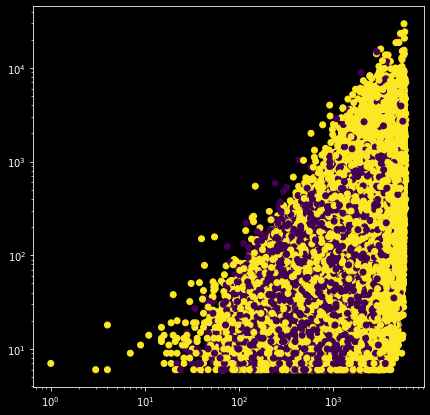

In [63]:
fig = plt.figure(figsize=(7, 7))
ax = plt.axes()

ax.scatter(restaurants_df["total_duration"],restaurants_df["total_visit_count"], c=restaurants_df["is_open"])
ax.set_xscale("log")
ax.set_yscale("log")

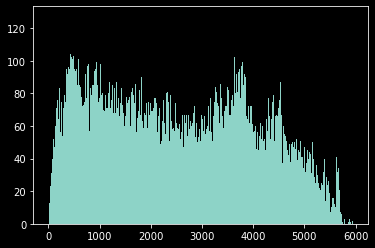

In [64]:
plt.hist(restaurants_df["total_duration"], bins=1000);

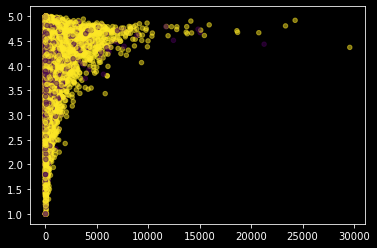

In [78]:
plt.scatter(restaurants_df["total_visit_count"], restaurants_df["scaled_weighted_stars"], c=restaurants_df["is_open"], alpha=0.5, s=20)

In [79]:
restaurants_df["total_visit_count"].describe()

count    62089.000000
mean       315.237466
std        691.316637
min          6.000000
25%         37.000000
50%        105.000000
75%        313.000000
max      29586.000000
Name: total_visit_count, dtype: float64

In [92]:
restaurants_df["scaled_weighted_stars"].describe()

count    62089.000000
mean         4.102337
std          0.714620
min          1.000000
25%          3.781380
50%          4.290743
75%          4.619104
max          5.000000
Name: scaled_weighted_stars, dtype: float64

In [97]:
mania = restaurants_df[(restaurants_df["scaled_weighted_stars"] >= 4.619104) & (restaurants_df["total_visit_count"] < 315.237466)]
pop = restaurants_df[(restaurants_df["scaled_weighted_stars"] >= 4.619104) & (restaurants_df["total_visit_count"] >= 315.237466)]
unpop = restaurants_df[(restaurants_df["scaled_weighted_stars"] < 4.619104) & (restaurants_df["total_visit_count"] < 315.237466)] 

In [98]:
get_closed_ratio(mania)
get_closed_ratio(pop)
get_closed_ratio(unpop)

38.08%
random: 33.72%
18.47%
random: 34.66%
37.6%
random: 33.76%


## Per city

In [ ]:
drop_ids = []
fig, ax = plt.subplots(figsize=(7,7))
for g in np.unique(restaurants_df["state"]):
    ix = np.where(restaurants_df["state"] == g)[0]
    if ix.shape[0] < 2:
        drop_ids.extend(ix.tolist())
        continue
    ax.scatter(restaurants_df["latitude"].values[ix], restaurants_df["longitude"].values[ix], label = g)
ax.legend()

plt.show()

In [ ]:
restaurants_df = restaurants_df.drop(restaurants_df.index[drop_ids])

In [ ]:
city_dfs = []
for g in np.unique(restaurants_df["state"]):
    city_dfs.append(restaurants_df[restaurants_df["state"] == g])

In [ ]:
[len(df) for df in city_dfs]